# Data exploration for the Cloud to Street - Microsoft Flood Dataset
This notebook is an adaptation of https://data.source.coop/c2sms/c2smsfloods/Training_S1_Baseline.ipynb.

Here we're exploring the Cloud to Street - Microsoft Flood Dataset obtained from [Source Cooperative](https://beta.source.coop/repositories/c2sms/c2smsfloods/description/). It contains near-coincident Sentinel-1 (RTC VV and VH) and Sentinel-2 L1C (13 band, TOA) scenes. The images are tiled in 512x512 chips. Labels include a water mask (for both Sentinel-1 and Sentinel-2) and cloud/cloud shadow mask (for Sentinel-2). Specifically, these labels are stored as GeoTIFFs with values (`0: Not Water, 1: Water, 255: NoData`) for the water mask and (`0: Background, 1: Cloud, 255: NoData`) for the cloud mask.

**Sentinel-1 temporal range**: `=2016-08-12 to 2020-10-20

**Sentinel-2 temporal range**: 2016-08-12 to 2020-10-22

**Citation**:

Cloud to Street, Microsoft, Radiant Earth Foundation. (2022). A global flood events and cloud cover dataset (Version 1.0). [Date Accessed]. Radiant MLHub.
https://doi.org/10.34911/rdnt.oz32gz

# Visualize the data

The dataset consists of 900 [Sentinel 1](https://sentinel.esa.int/web/sentinel/missions/sentinel-1) and coincident [Sentinel 2](https://sentinel.esa.int/web/sentinel/missions/sentinel-2) chips of size 512x512 px together with pixel-wise water labels.

The scenes are very close in time, but can be up to 3 days apart. Hence, the water labels can also be slightly different.

In [4]:
import albumentations
import glob
import matplotlib.pyplot as plt
import numpy as np
import os
import tifffile
import time
import torch
import torch.nn as nn

Sentinel-1 performs synthetic aperture radar (SAR) imaging, enabling it to see in all weather conditions and day and night. To better visualize the bands or channels of Sentinel-1 images we will create a false color composite by treating the two bands and their ratio as red, green and blue channels.

Sentinel-2 uses an multispectral optical sensor that captures reflected light in the visible and infrared spectrum. We are using the shortwave infrared, near infrared, and green composite which is great for spotting water. You can find out more about false color composites [here](https://earthobservatory.nasa.gov/features/FalseColor).

Modification 12/5/2023: also providing a visualization function for a RGB true color composite.

Helper functions for visualizations:

In [5]:
def visualize_s2_img(s2_channel_paths):
    """
    Calculates and returns a 'SWIR' S2 false color composite ready for visualization.

    Args:
        s2_channel_paths (list of str): Paths to the ['B12', 'B7', 'B4'] bands of a S2 image.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    img = []
    for path in s2_channel_paths:
        img.append(tifffile.imread(path))
    img = np.stack(img, axis=-1)
    return scale_S1_S2_img(img, sentinel=2)

def visualize_s2_img_rgb(s2_channel_paths):
    """
    Calculates and returns a 'RGB' S2 true color composite ready for visualization.

    Args:
        s2_channel_paths (list of str): Paths to the ['B4', 'B3', 'B2'] bands of a S2 image.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    img = []
    for path in s2_channel_paths:
        img.append(tifffile.imread(path))
    img = np.stack(img, axis=-1)
    return scale_S1_S2_img(img, sentinel=2)

def visualize_s1_img(path_vv, path_vh):
    """
    Calculates and returns a S1 false color composite ready for visualization.

    Args:
        path_vv (str): Path to the VV band.
        path_vh (str): Path to the VH band.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    s1_img = np.stack((tifffile.imread(path_vv), tifffile.imread(path_vh)), axis=-1)

    img = np.zeros((s1_img.shape[0], s1_img.shape[1], 3), dtype=np.float32)
    img[:, :, :2] = s1_img.copy()
    img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]
    s1_img = np.nan_to_num(s1_img)
    return scale_S1_S2_img(img, sentinel=1)

def scale_S1_S2_img(matrix, sentinel=2):
    """
    Returns a scaled (H,W,D) image which is more easily visually inspectable. Image is linearly scaled between
    min and max_value of by channel

    Args:
        matrix (np.array): (H,W,D) image to be scaled
        sentinel (int, optional): Sentinel 1 or Sentinel 2 image? Determines the min and max values for scalin, defaults to 2.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    w, h, d = matrix.shape
    min_values = np.array([100, 100, 100]) if sentinel == 2 else np.array([-23, -28, 0.2])
    max_values = np.array([3500, 3500, 3500]) if sentinel == 2 else np.array([0, -5, 1])

    matrix = np.reshape(matrix, [w * h, d]).astype(np.float64)
    matrix = (matrix - min_values[None, :]) / (max_values[None, :] - min_values[None, :])
    matrix = np.reshape(matrix, [w, h, d])

    matrix = matrix.clip(0, 1)
    return matrix

__Let's plot some random Sentinel-1 chips, their water labels and corresponding Sentinel-2 images with their water labels.__

chips/3e71513a-ec54-4e9b-aae6-93a8a3648763/s1/S1B_IW_GRDH_1SDV_20180805T111057_20180805T111127_012127_016547_9662_06542-03224/LabelWater.tif


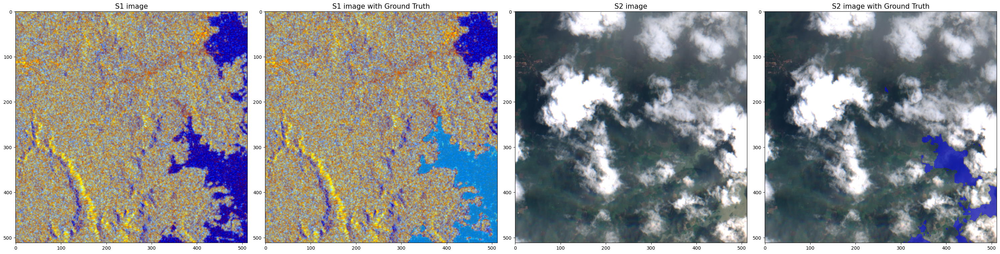

chips/3e71513a-ec54-4e9b-aae6-93a8a3648763/s1/S1B_IW_GRDH_1SDV_20180805T111127_20180805T111152_012127_016547_650C_00514-06086/LabelWater.tif


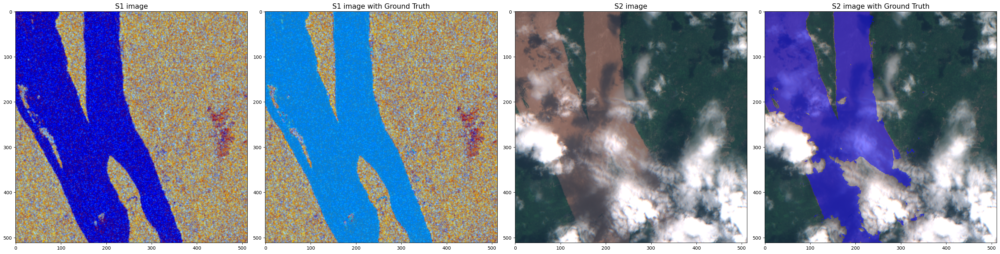

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_04399-04414/LabelWater.tif


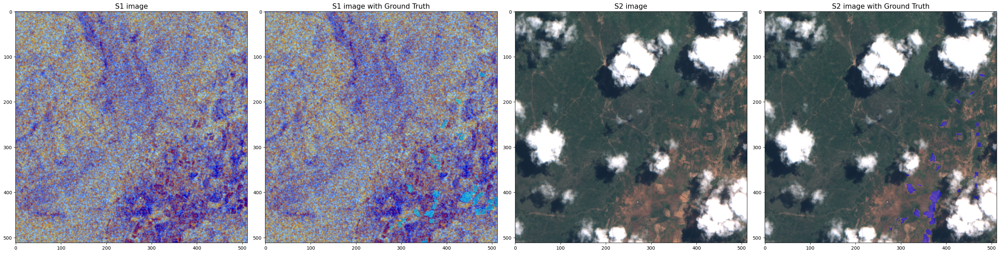

In [6]:
S1_label_paths = sorted(glob.glob("chips/*/s1/*/LabelWater.tif"))

b_channels = ['B12', 'B7', 'B4']
rgb_channels = ['B4', 'B3', 'B2']
show_how_many = 3
alpha = 0.5

for k in range(show_how_many):
    rand_int = np.random.randint(len(S1_label_paths))
    S1_label_path = S1_label_paths[rand_int]
    S1_VV_path = S1_label_path.replace("LabelWater.tif", "VV.tif")
    S1_VH_path = S1_label_path.replace("LabelWater.tif", "VH.tif")

    flood_event = S1_label_path.split("/")[1]
    position = S1_label_path.split("/")[-2].split("_")[-1]

    S2_label_path = glob.glob(f"chips/{flood_event}/s2/*{position}/LabelWater.tif")[0]
    S2_bands_paths = [S2_label_path.replace("LabelWater.tif", f"{channel}.tif") for channel in rgb_channels] # b_channels]

    f, axarr = plt.subplots(1, 4, figsize=(30, 10))
    print(S1_label_path)
    s1_img = visualize_s1_img(S1_VV_path, S1_VH_path)
    axarr[0].imshow(s1_img)
    axarr[0].set_title("S1 image", fontsize=15)
    s2_img = visualize_s2_img_rgb(S2_bands_paths) # visualize_s2_img(S2_bands_paths)
    axarr[1].imshow(s1_img)
    axarr[1].set_title("S1 image with Ground Truth", fontsize=15)

    axarr[2].imshow(s2_img)
    axarr[2].set_title("S2 image", fontsize=15)
    axarr[3].imshow(s2_img)
    axarr[3].set_title("S2 image with Ground Truth", fontsize=15)

    label = tifffile.imread(S1_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[1].imshow(label, cmap="cool", alpha=alpha)

    label = tifffile.imread(S2_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[3].imshow(label, cmap="winter", alpha=alpha)

    plt.tight_layout()
    plt.show()

# Set up a dataloader with PyTorch for segmentation

## Split the data into train, validation and test set

We start out with a simple random 70%/20%/10% train, validation and test split.

In [ ]:
train_percentage = 0.7
val_percentage = 0.20
test_percentage = 0.10

S1_label_paths = sorted(glob.glob("chips/*/s1/*/LabelWater.tif"))
S1_img_paths = [[path.replace("LabelWater.tif", "VV.tif"), path.replace("LabelWater.tif", "VH.tif")] for path in S1_label_paths]

np.random.seed(1778)
np.random.shuffle(S1_label_paths)
np.random.seed(1778)
np.random.shuffle(S1_img_paths)

S1_img_paths_train = S1_img_paths[: int(train_percentage * len(S1_img_paths))]
S1_img_paths_val = S1_img_paths[int(train_percentage * len(S1_img_paths)): int((train_percentage + val_percentage) * len(S1_img_paths))]
S1_img_paths_test = S1_img_paths[int((train_percentage + val_percentage) * len(S1_img_paths)):]

S1_label_paths_train = S1_label_paths[: int(train_percentage * len(S1_label_paths))]
S1_label_paths_val = S1_label_paths[int(train_percentage * len(S1_label_paths)): int((train_percentage + val_percentage) * len(S1_label_paths))]
S1_label_paths_test = S1_label_paths[int((train_percentage + val_percentage) * len(S1_label_paths)):]

print(f"Train has {len(S1_img_paths_train)} images and {len(S1_label_paths_train)} labels")
print(f"Val   has {len(S1_img_paths_val)} images and {len(S1_label_paths_val)} labels")
print(f"Test  has {len(S1_img_paths_test)} images and {len(S1_label_paths_test)} labels")

## Create PyTorch datasets and look at some samples

The two channels of Sentinel-1 (VV and VH) are in float32 and have both negative and positive values. We normalize them to lie between 0 and 1 by applying [min-max normalization](https://en.wikipedia.org/wiki/Feature_scaling#Rescaling_.28min-max_normalization.29) with min = -77 and max = 26.

In [ ]:
class Sentinel1_Dataset(torch.utils.data.Dataset):
    def __init__(
        self,
        img_paths,
        mask_paths,
        transforms=None,
        min_normalize=-77,
        max_normalize=26,
    ):
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.transforms = transforms
        self.min_normalize = min_normalize
        self.max_normalize = max_normalize

    def __getitem__(self, idx):
        # Load in image
        arr_x = []
        for path in self.img_paths[idx]:
            arr_x.append(tifffile.imread(path))
        arr_x = np.stack(arr_x, axis=-1)

        # Min-Max Normalization
        arr_x = np.clip(arr_x, self.min_normalize, self.max_normalize)
        arr_x = (arr_x - self.min_normalize) / (self.max_normalize - self.min_normalize)

        sample = {"image": arr_x}

        # Load in label mask
        sample["mask"] = tifffile.imread(self.mask_paths[idx])

        # Apply Data Augmentation
        if self.transforms:
            sample = self.transforms(image=sample["image"], mask=sample["mask"])
        if sample["image"].shape[-1] < 20:
            sample["image"] = sample["image"].transpose((2, 0, 1))

        return sample

    def __len__(self):
        return len(self.img_paths)

    def visualize(self, how_many=1, show_specific_index=None):
        for _ in range(how_many):
            rand_int = np.random.randint(len(self.img_paths))
            if show_specific_index is not None:
                rand_int = show_specific_index
            print(self.img_paths[rand_int][0])
            f, axarr = plt.subplots(1, 3, figsize=(30, 9))
            axarr[0].imshow(visualize_s1_img(self.img_paths[rand_int][0], self.img_paths[rand_int][1]))
            sample = self.__getitem__(rand_int)

            img = sample["image"]
            axarr[0].set_title(f"FCC of original S1 image", fontsize=15)
            axarr[1].imshow(img[0]) # Just visualize the VV band here
            axarr[1].set_title(f"VV band returned from the dataset, Min: {img.min():.4f}, Max: {img.max():.4f}", fontsize=15)
            if "mask" in sample.keys():
                axarr[2].set_title(f"Corresponding water mask: {(sample['mask'] == 1).sum()} px", fontsize=15)
                mask = mask_to_img(sample["mask"], {1: (0, 0, 255)})
                axarr[2].imshow(mask)
            plt.tight_layout()
            plt.show()

def mask_to_img(label, color_dict):
    """Recodes a (H,W) mask to a (H,W,3) RGB image according to color_dict"""
    mutually_exclusive = np.zeros(label.shape + (3,), dtype=np.uint8)
    for key in range(1, len(color_dict.keys()) + 1):
        mutually_exclusive[label == key] = color_dict[key]
    return mutually_exclusive

To prevent overfitting while training, we apply typical data augmentations like random cropping and random 90 degree rotations, horizontal and vertical flipping.

For validation, we don't apply any data augmentations and just predict on the full 512x512 chips.

In [ ]:
train_crop_size = 256

train_transforms = albumentations.Compose(
    [
        albumentations.RandomCrop(train_crop_size, train_crop_size),
        albumentations.RandomRotate90(),
        albumentations.HorizontalFlip(),
        albumentations.VerticalFlip()
    ]
)

train_dataset = Sentinel1_Dataset(
    S1_img_paths_train,
    S1_label_paths_train,
    transforms=train_transforms,
    min_normalize=-77,
    max_normalize=26,
    )

val_dataset = Sentinel1_Dataset(
    S1_img_paths_val,
    S1_label_paths_val,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )

test_dataset = Sentinel1_Dataset(
    S1_img_paths_test,
    S1_label_paths_test,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )
print(len(train_dataset), len(val_dataset), len(test_dataset))

Let's visualize some examples from the datasets.

chips/3e71513a-ec54-4e9b-aae6-93a8a3648763/s1/S1B_IW_GRDH_1SDV_20180805T111057_20180805T111127_012127_016547_9662_09528-09142/VV.tif


<ipython-input-28-80823a4b9ff7>:48: RuntimeWarning: invalid value encountered in divide
  img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]


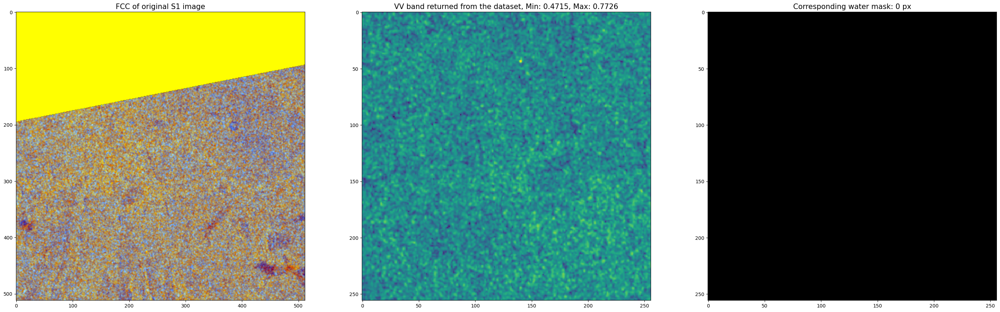

chips/3e71513a-ec54-4e9b-aae6-93a8a3648763/s1/S1B_IW_GRDH_1SDV_20180805T111057_20180805T111127_012127_016547_9662_09549-05250/VV.tif


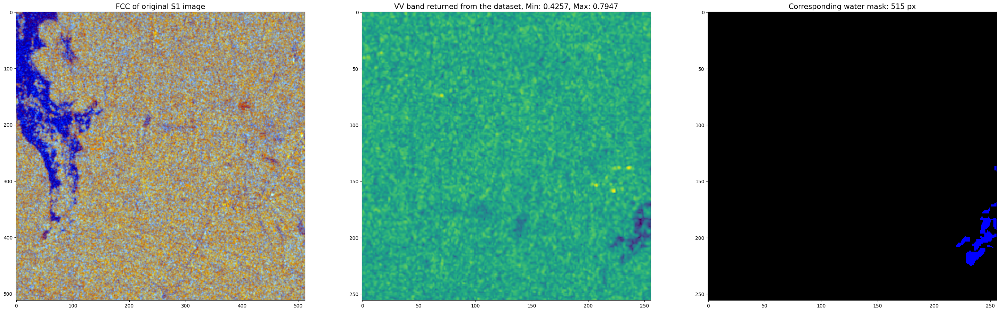

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151605_20180507T151630_010817_013C63_C906_09293-03569/VV.tif


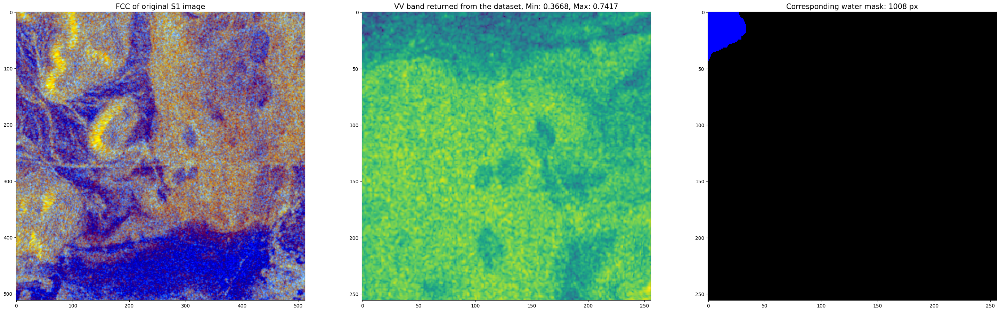

In [ ]:
train_dataset.visualize(3)

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_02356-00005/VV.tif


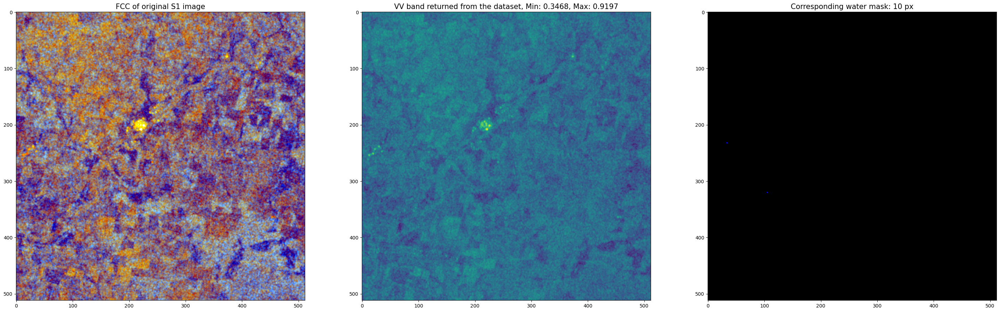

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_05421-03906/VV.tif


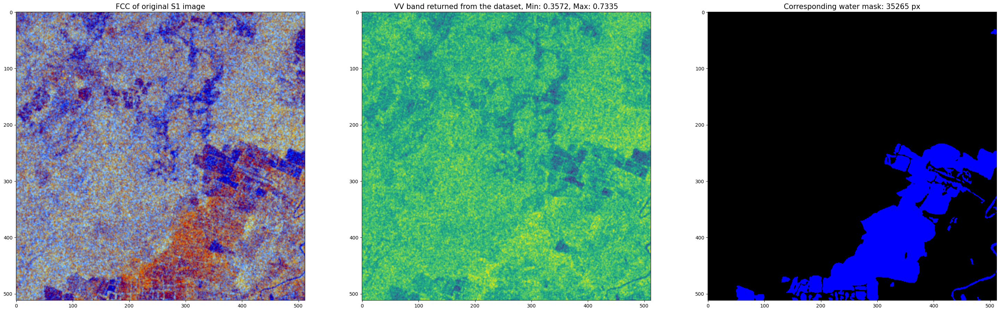

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151540_20180507T151605_010817_013C63_FF38_03375-08316/VV.tif


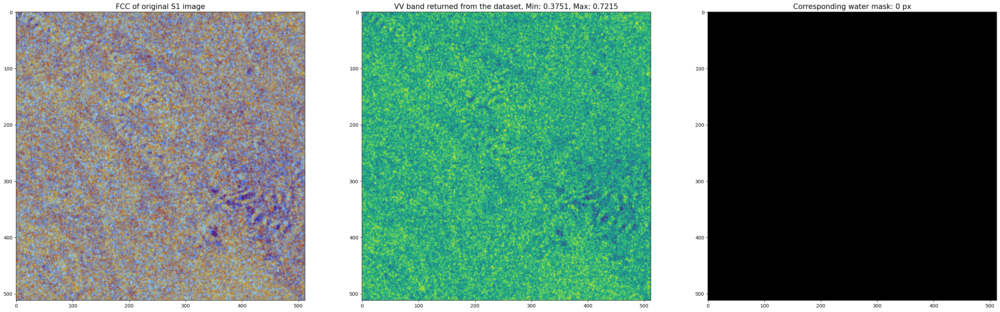

In [ ]:
val_dataset.visualize(3)

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151540_20180507T151605_010817_013C63_FF38_01331-07128/VV.tif


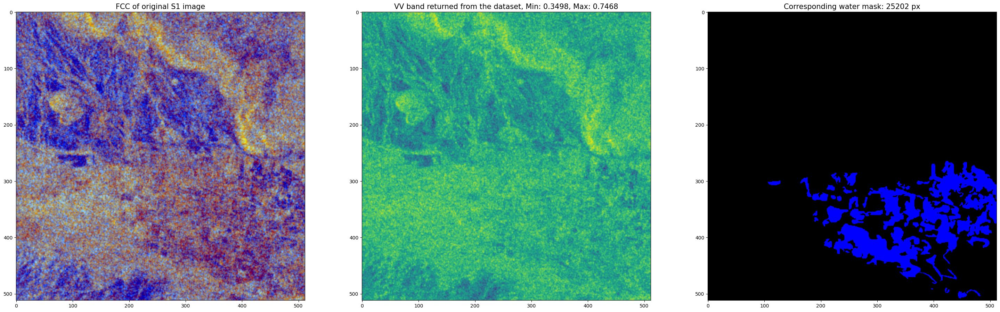

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_08488-04921/VV.tif


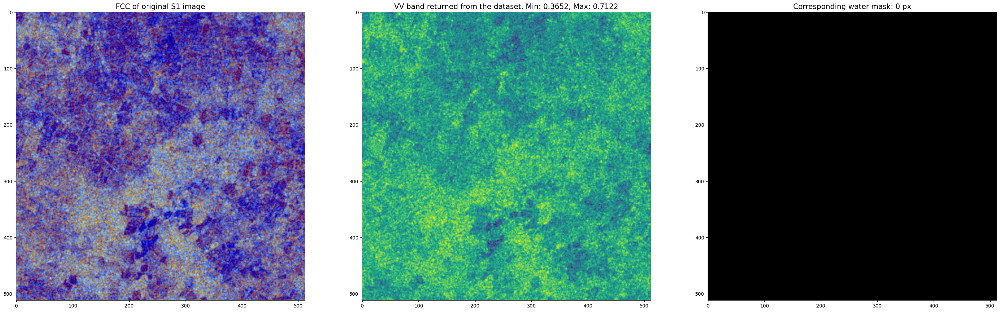

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151540_20180507T151605_010817_013C63_FF38_01331-07128/VV.tif


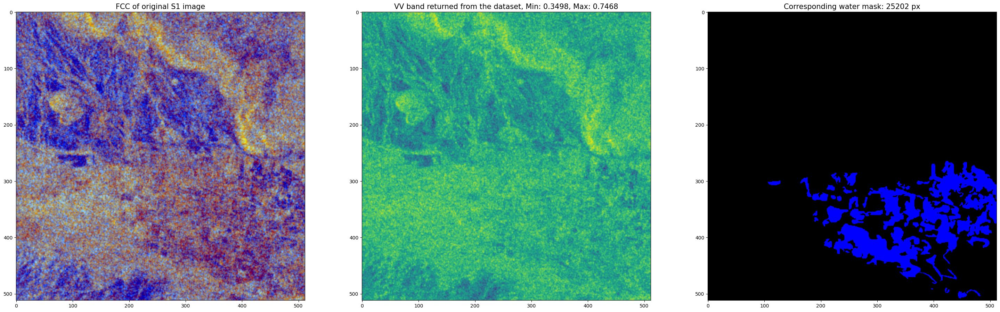

In [ ]:
test_dataset.visualize(3)